## XGBoost-Ax　のサンプルコード（train, valid, test使用）

In [1]:
%load_ext lab_black

In [2]:
# ライブラリーのインポート
import os

import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
from ax.utils.notebook.plotting import render, init_notebook_plotting

%matplotlib inline

# ボストンの住宅価格データ
from sklearn.datasets import load_boston

# 前処理
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# XGBoost
import xgboost as xgb

# Ax
import ax
from ax import (
    ParameterType,
    RangeParameter,
    SearchSpace,
    SimpleExperiment,
    modelbridge,
    models,
)

# 評価指標
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error

import warnings

warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(action="ignore", category=pd.core.common.SettingWithCopyWarning)

In [3]:
print(xgb.__version__)

1.3.3


In [4]:
print(ax.__version__)

0.2.0


In [5]:
# データセットの読込み
boston = load_boston()

# 説明変数の格納
df = pd.DataFrame(boston.data, columns=boston.feature_names)
# 目的変数の追加
df["MEDV"] = boston.target

# データの中身を確認
df.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2


#### 前処理

In [6]:
# ランダムシード値
RANDOM_STATE = 10

# 学習データと評価データの割合
TEST_SIZE = 0.2

# 学習データと評価データを作成
x_train, x_test, y_train, y_test = train_test_split(
    df.iloc[:, 0 : df.shape[1] - 1],
    df.iloc[:, df.shape[1] - 1],
    test_size=TEST_SIZE,
    random_state=RANDOM_STATE,
)

# trainのデータセットの2割をモデル学習時のバリデーションデータとして利用する
x_train, x_valid, y_train, y_valid = train_test_split(
    x_train, y_train, test_size=TEST_SIZE, random_state=RANDOM_STATE
)

In [7]:
search_space = SearchSpace(
    parameters=[
        RangeParameter(
            name="eta",
            parameter_type=ParameterType.FLOAT,
            lower=1e-8,
            upper=1.0,
            log_scale=True,
        ),
        RangeParameter(
            name="gamma",
            parameter_type=ParameterType.FLOAT,
            lower=1e-8,
            upper=1.0,
            log_scale=True,
        ),
        RangeParameter(
            name="max_depth",
            parameter_type=ParameterType.INT,
            lower=3,
            upper=8,
            log_scale=False,
        ),
        RangeParameter(
            name="min_child_weight",
            parameter_type=ParameterType.FLOAT,
            lower=1,
            upper=60,
            log_scale=True,
        ),
        RangeParameter(
            name="max_delta_step",
            parameter_type=ParameterType.FLOAT,
            lower=1e-8,
            upper=1.0,
            log_scale=True,
        ),
        RangeParameter(
            name="subsample",
            parameter_type=ParameterType.FLOAT,
            lower=0.0,
            upper=1.0,
            log_scale=False,
        ),
        RangeParameter(
            name="reg_lambda",
            parameter_type=ParameterType.FLOAT,
            lower=0.0,
            upper=1000.0,
            log_scale=False,
        ),
        RangeParameter(
            name="reg_alpha",
            parameter_type=ParameterType.FLOAT,
            lower=0.0,
            upper=1000.0,
            log_scale=False,
        ),
    ]
)

In [8]:
def evaluation_function(parameterization, weight=None):

    model = xgb.XGBRegressor(
        eta=parameterization["eta"],
        gamma=parameterization["gamma"],
        max_depth=parameterization["max_depth"],
        min_child_weight=parameterization["min_child_weight"],
        max_delta_step=parameterization["max_delta_step"],
        subsample=parameterization["subsample"],
        reg_lambda=parameterization["reg_lambda"],
        reg_alpha=parameterization["reg_alpha"],
    )

    model.fit(
        x_train,
        y_train,
        eval_set=[(x_valid, y_valid)],
        early_stopping_rounds=50,
        verbose=False,
    )

    preds = model.predict(x_valid)
    mae = mean_absolute_error(y_valid, preds)

    return mae

In [9]:
%%time
# Axで最適値を見つける
exp = SimpleExperiment(name="test_Xgboost",
                       search_space=search_space,
                       evaluation_function=evaluation_function,
                       minimize=True,
                       objective_name="mae"
                      )

# ベイズ最適化
sobol = modelbridge.get_sobol(search_space=exp.search_space, seed=RANDOM_STATE)
print(f"Running Sobol initialization trials...")

for _ in range(5):
    exp.new_trial(generator_run=sobol.gen(1))
for i in range(50):
    print(f"Running GP+EI optimization tiral {i+1}...")
    gpei=modelbridge.get_GPEI(experiment=exp, data=exp.eval())
    exp.new_trial(generator_run=gpei.gen(1))

Running Sobol initialization trials...
Running GP+EI optimization tiral 1...
Running GP+EI optimization tiral 2...
Running GP+EI optimization tiral 3...
Running GP+EI optimization tiral 4...
Running GP+EI optimization tiral 5...
Running GP+EI optimization tiral 6...
Running GP+EI optimization tiral 7...
Running GP+EI optimization tiral 8...
Running GP+EI optimization tiral 9...
Running GP+EI optimization tiral 10...
Running GP+EI optimization tiral 11...
Running GP+EI optimization tiral 12...
Running GP+EI optimization tiral 13...
Running GP+EI optimization tiral 14...
Running GP+EI optimization tiral 15...
Running GP+EI optimization tiral 16...
Running GP+EI optimization tiral 17...
Running GP+EI optimization tiral 18...
Running GP+EI optimization tiral 19...
Running GP+EI optimization tiral 20...
Running GP+EI optimization tiral 21...
Running GP+EI optimization tiral 22...
Running GP+EI optimization tiral 23...
Running GP+EI optimization tiral 24...
Running GP+EI optimization tiral 2

In [10]:
dat = exp.eval()
dat.df

,arm_name,metric_name,mean,sem,trial_index
0,0_0,mae,20.835802,NaN,0
1,1_0,mae,20.835802,NaN,1
2,2_0,mae,20.835802,NaN,2
3,3_0,mae,20.835802,NaN,3
4,4_0,mae,20.835802,NaN,4
5,5_0,mae,20.835793,NaN,5
6,6_0,mae,20.835802,NaN,6
7,7_0,mae,20.835445,NaN,7
8,8_0,mae,20.834777,NaN,8
9,9_0,mae,20.830396,NaN,9


In [11]:
best_objectives = exp.eval().df["mean"]
bestParameter_score = np.min(best_objectives)
bestParameter_trial = np.argmin(best_objectives)
bestParameter = exp._trials[bestParameter_trial].arm.parameters
bestParameter["random_state"] = RANDOM_STATE
bestParameter

{'eta': 0.6504156283754524,
 'gamma': 5.2927570057348026e-08,
 'max_depth': 6,
 'min_child_weight': 33.468526469131646,
 'max_delta_step': 1.0,
 'subsample': 0.8434249499376619,
 'reg_lambda': 29.866681136050957,
 'reg_alpha': 0.0,
 'random_state': 10}

In [12]:
# チューニングしたハイパーパラメーターをフィット
optimised_model = xgb.XGBRegressor(**(bestParameter))

optimised_model.fit(x_train, y_train)

# XGBoost推論
y_pred = optimised_model.predict(x_test)

In [13]:
# 評価
def calculate_scores(true, pred):
    """全ての評価指標を計算する

    Parameters
    ----------
    true (np.array)       : 実測値
    pred (np.array)       : 予測値

    Returns
    -------
    scores (pd.DataFrame) : 各評価指標を纏めた結果

    """
    scores = {}
    scores = pd.DataFrame(
        {
            "R2": r2_score(true, pred),
            "MAE": mean_absolute_error(true, pred),
            "MSE": mean_squared_error(true, pred),
            "RMSE": np.sqrt(mean_squared_error(true, pred)),
        },
        index=["scores"],
    )
    return scores

In [14]:
scores = calculate_scores(y_test, y_pred)
print(scores)

              R2       MAE        MSE      RMSE
scores  0.826878  3.116676  18.105243  4.255026


### 探索過程の可視化

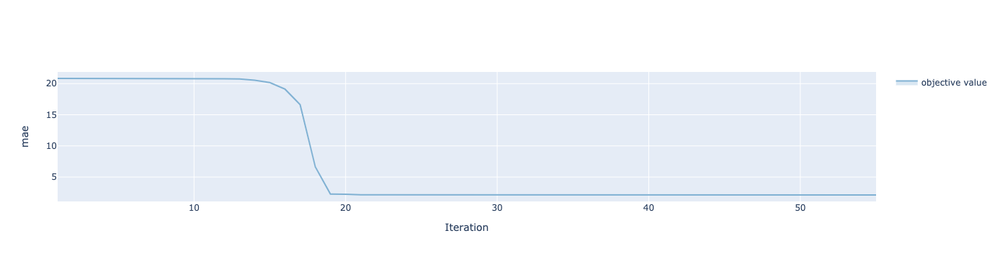

In [15]:
from ax.plot.trace import optimization_trace_single_method

best_objectives = np.array([[trial.objective_mean for trial in exp.trials.values()]])
best_objective_plot = optimization_trace_single_method(
    y=np.minimum.accumulate(best_objectives, axis=1), ylabel="mae",
)
render(best_objective_plot)

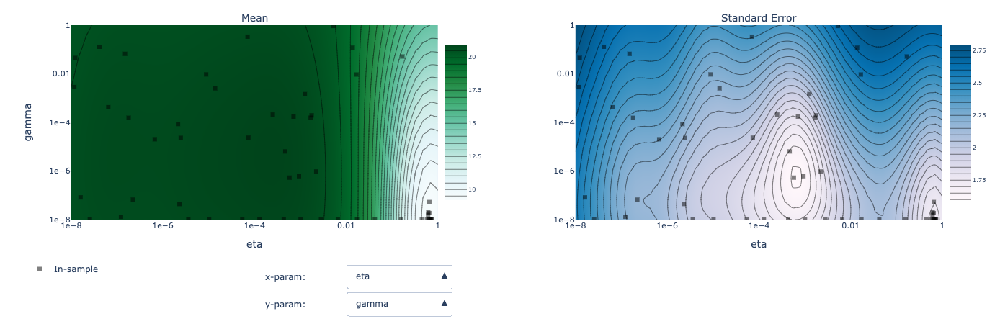

In [16]:
from ax.plot.contour import interact_contour

# 2つのパラメータを軸に取って期待値と標準偏差を表したグラフ
render(interact_contour(model=gpei, metric_name="mae"))

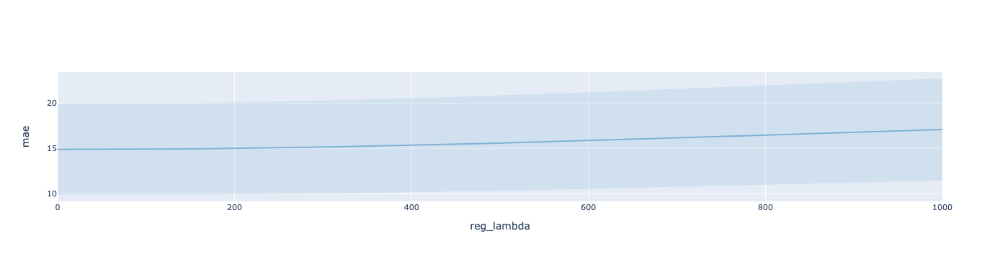

In [17]:
from ax.plot.slice import plot_slice

# パラメータ 1 つ選択してスコアの期待値と標準偏差を表したグラフ
render(plot_slice(gpei, "reg_lambda", "mae"))